### Merging pan-cancer dataset to 6 other single cell datasets together
- 1. 6 merged single cell datasets
- 2. pan-cancer cell line dataset

In [1]:
import os
import sys
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import anndata as an
from scipy.sparse import csr_matrix
sc.settings.set_figure_params(dpi=100)
sns.set()

### 1. Before merge

In [2]:
root_dir = r'../datasets/single_cell/'

In [3]:
dataset2file = {
'merged_6_ds': {'file_dir': root_dir, 'file_name': 'merged_6_sc_datasets.h5ad'},
'pan_cancer_ds': {'file_dir': root_dir, 'file_name': '07_pan_cancer_07_GSE157220_log2cpm1p_filtered.h5ad'},
}

In [4]:
# read data
all_dataset = {}
for dataset_id, file_info in dataset2file.items():
    print('--------------------Reading {}-----------------'.format(dataset_id))
    all_dataset[dataset_id] = sc.read_h5ad(os.path.join(file_info["file_dir"], file_info["file_name"]))
    print(all_dataset[dataset_id])
    # print(all_dataset[dataset_id].obs['leiden'].value_counts())

--------------------Reading merged_6_ds-----------------
AnnData object with n_obs × n_vars = 112807 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group', 'leiden', 'cell_type'
    var: 'gene_ids'
    uns: 'dataset_id_colors', 'dendrogram_leiden', 'hit_cell_type_colors', 'leiden', 'leiden_1st_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
--------------------Reading pan_cancer_ds-----------------
AnnData object with n_obs × n_vars = 30853 × 12114
    obs: 'cell_type', 'dataset_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'dendrogram_leiden', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'co

#### Cell types assignment
- Dataset 2, 3 and 6 provided cell type for each cell, only kept the cells that reannotated cell type is same as provided cell types;
- Treating all `Epithelial Cells` and `Ductal Cells` as `Cancer Cells`;

##### Check cell type in dataset `merged_6_ds`

In [5]:
all_dataset['merged_6_ds'].obs.head(2)

,sample_id,leiden_1st,dataset_id,hit_cell_type,m_max_cd4/mean_cd8,m_cd4/m_cd8 group,leiden,cell_type
AAACCTGTCTTCGAGA-1_HNSCC_1_TIL-0-0-0-0-0,HNSCC_1_TIL,Neu / Mac,hnscc_cillo_01,Macrophages,2.0,high,Macrophages (2),Macrophages
AAAGATGAGCTAGTCT-1_HNSCC_1_TIL-0-0-0-0-0,HNSCC_1_TIL,Macrophages,hnscc_cillo_01,Macrophages,2.0,high,Macrophages (1),Macrophages


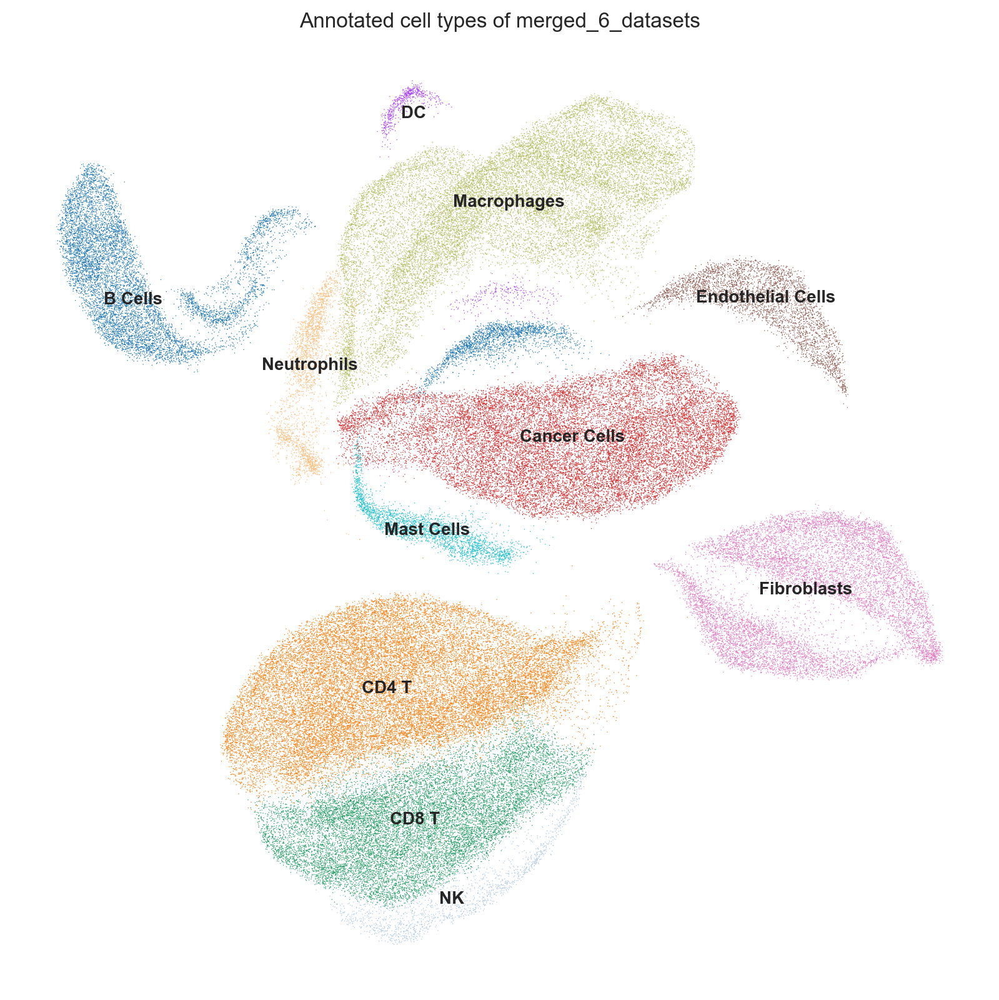

In [6]:
rcParams['figure.figsize'] = 10, 10
sc.pl.umap(all_dataset['merged_6_ds'], color='cell_type', legend_loc='on data', legend_fontsize='small', 
           title='Annotated cell types of merged_6_datasets', frameon=False)

##### Check cell type in dataset `pan_cancer_ds`

In [7]:
all_dataset['pan_cancer_ds'].obs.head(2)

,cell_type,dataset_id,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden
AAACCTGAGACATAAC-1-18,Cancer Cells,pan_cancer_07,4318,4318,999999.9375,37968.406250,3.796841,54
AACGTTGTCACCCGAG-1-18,Cancer Cells,pan_cancer_07,5200,5200,1000000.0000,34923.253906,3.492326,54


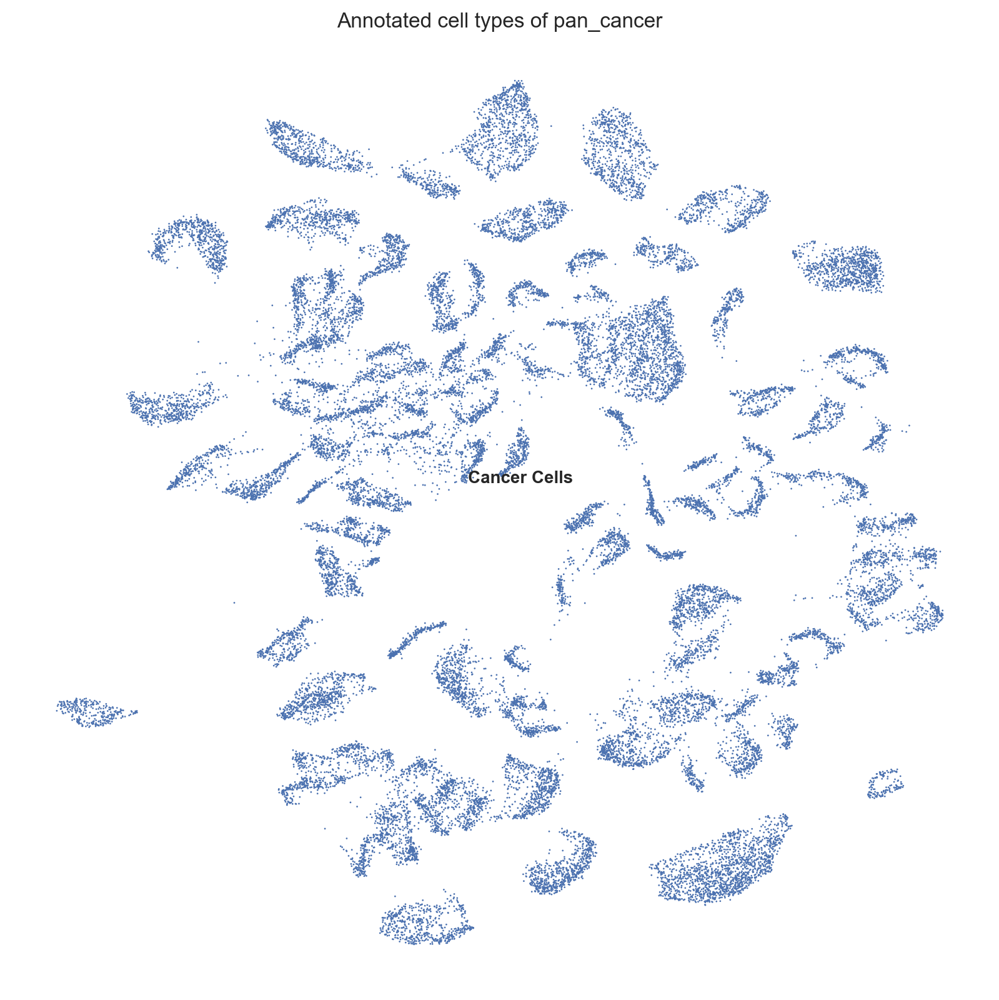

In [8]:
rcParams['figure.figsize'] = 10, 10
sc.pl.umap(all_dataset['pan_cancer_ds'], color='cell_type', legend_loc='on data', legend_fontsize='small', 
           title='Annotated cell types of pan_cancer', frameon=False)

#### Rescaling
1. Normalize to 1 million (CPM) for each cell;
2. Log transform, $log_2(x+1)$;

- CPM: counts per million

In [9]:
all_dataset_rescaled = {}
for di, dataset in all_dataset.items():
    print('--------------------deal with {}-----------------'.format(di))
    dataset.X = csr_matrix(np.power(2, dataset.X.A) - 1)  # non-log
    # merged_dataset_new.X = csr_matrix(dense_matrix)
    sc.pp.normalize_total(dataset, target_sum=1e6)
    sc.pp.log1p(dataset, base=2)
    all_dataset_rescaled[di] = dataset

--------------------deal with merged_6_ds-----------------
--------------------deal with pan_cancer_ds-----------------


In [10]:
dataset_names = ["merged_6_ds", "pan_cancer_ds"]

In [11]:
inx2dataset = {(i, j): dataset_names[i + j] for i in range(1) for j in range(2)}
inx2dataset

{(0, 0): 'merged_6_ds', (0, 1): 'pan_cancer_ds'}

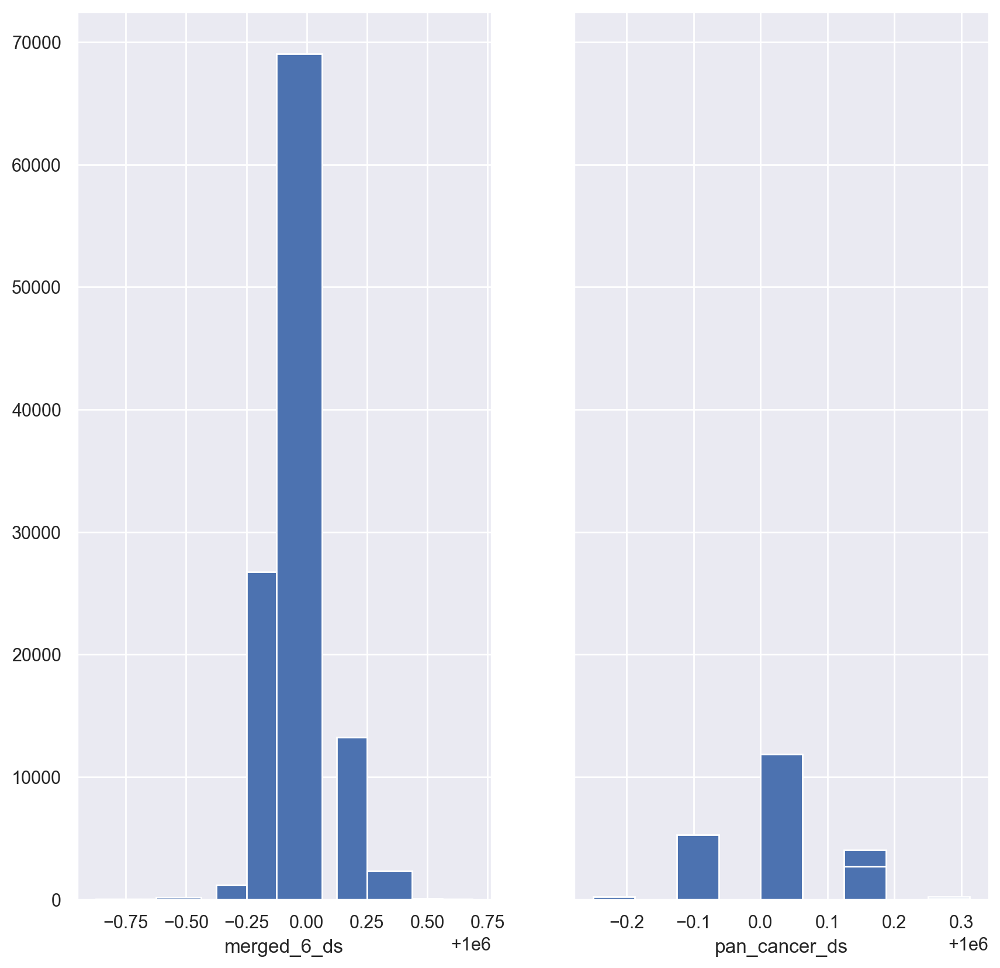

In [12]:
fig, ax = plt.subplots(1, 2, sharex='col', sharey='row')
for i in range(1):
    for j in range(2):
        current_dataset = inx2dataset[(i,j)]
        ax[j].hist((np.power(2, all_dataset_rescaled[current_dataset].X.A) - 1).sum(axis=1))
        ax[j].set_xlabel(current_dataset)

In [13]:
all_dataset_new = all_dataset_rescaled.copy()

### 2. Merge 6 datasets with pan-cancer dataset

In [14]:
merged_dataset = None
all_dataset_id = list(all_dataset_new.keys())
for i in range(len(all_dataset_id)-1):
    print('dealing with {}'.format([all_dataset_id[i]]))
    next_dataset = all_dataset_new[all_dataset_id[i+1]]
    if merged_dataset is None:
        current_dataset = all_dataset_new[all_dataset_id[i]]
        merged_dataset = current_dataset.concatenate(next_dataset)
    else:
        merged_dataset = merged_dataset.concatenate(next_dataset)

dealing with ['merged_6_ds']


In [15]:
merged_dataset

AnnData object with n_obs × n_vars = 143660 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group', 'leiden', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'gene_ids-0', 'mt-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1'
    obsm: 'X_pca', 'X_umap'

In [16]:
merged_dataset.obs = merged_dataset.obs.loc[:, ['sample_id', 'leiden_1st', 'dataset_id', 'cell_type', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group']]
merged_dataset.var = merged_dataset.var.loc[:, ['gene_ids-0']]
merged_dataset.var.rename(columns={'gene_ids-0': 'gene_ids'}, inplace=True)
merged_dataset

AnnData object with n_obs × n_vars = 143660 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'cell_type', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group'
    var: 'gene_ids'
    obsm: 'X_pca', 'X_umap'

In [17]:
merged_dataset.obs.head(2)

,sample_id,leiden_1st,dataset_id,cell_type,hit_cell_type,m_max_cd4/mean_cd8,m_cd4/m_cd8 group
AAACCTGTCTTCGAGA-1_HNSCC_1_TIL-0-0-0-0-0-0,HNSCC_1_TIL,Neu / Mac,hnscc_cillo_01,Macrophages,Macrophages,2.0,high
AAAGATGAGCTAGTCT-1_HNSCC_1_TIL-0-0-0-0-0-0,HNSCC_1_TIL,Macrophages,hnscc_cillo_01,Macrophages,Macrophages,2.0,high


In [18]:
merged_dataset.obs.dataset_id.unique()

array(['hnscc_cillo_01', 'pdac_pengj_02', 'hnscc_puram_03',
       'pdac_steele_04', 'luad_kim_05', 'nsclc_guo_06', 'pan_cancer_07'],
      dtype=object)

#### PCA

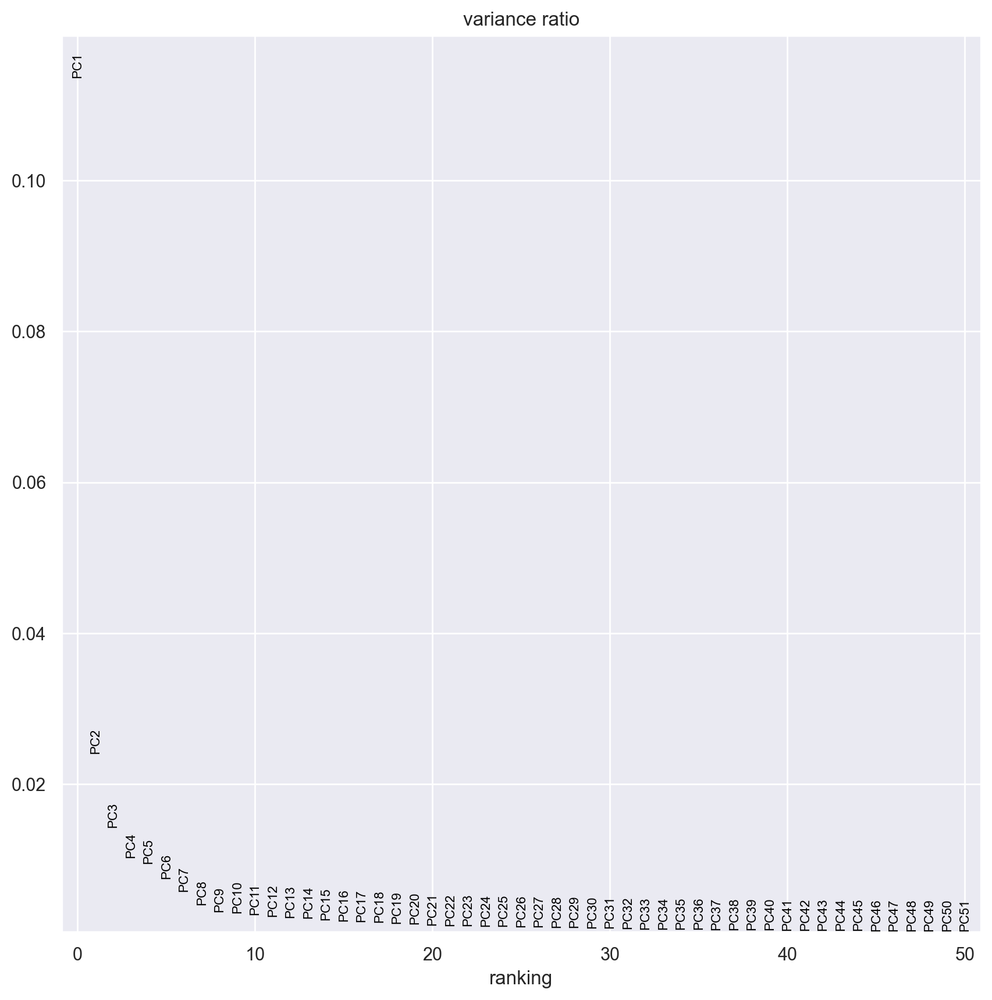

In [19]:
sc.tl.pca(merged_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=True)
sc.pl.pca_variance_ratio(merged_dataset, n_pcs=50)

#### Befor removing batch effect

... storing 'sample_id' as categorical
... storing 'leiden_1st' as categorical
... storing 'dataset_id' as categorical
... storing 'cell_type' as categorical
... storing 'hit_cell_type' as categorical
... storing 'm_cd4/m_cd8 group' as categorical


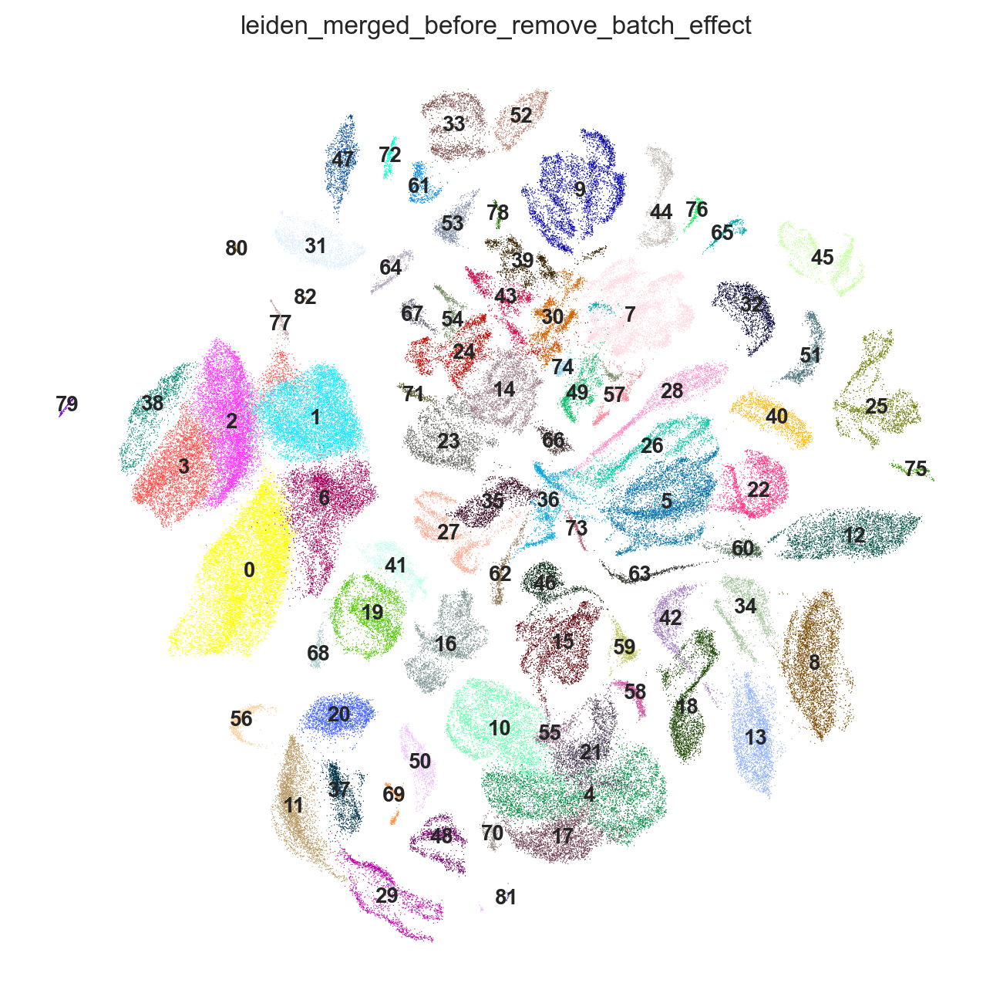

In [20]:
sc.pp.neighbors(merged_dataset, n_neighbors=10, n_pcs=50)
sc.tl.umap(merged_dataset)
sc.tl.leiden(merged_dataset)
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(merged_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', 
           title='leiden_{}'.format('merged_before_remove_batch_effect'), frameon=False, 
           save='_merged_before_remove_batch_effect_leiden_7ds.png')

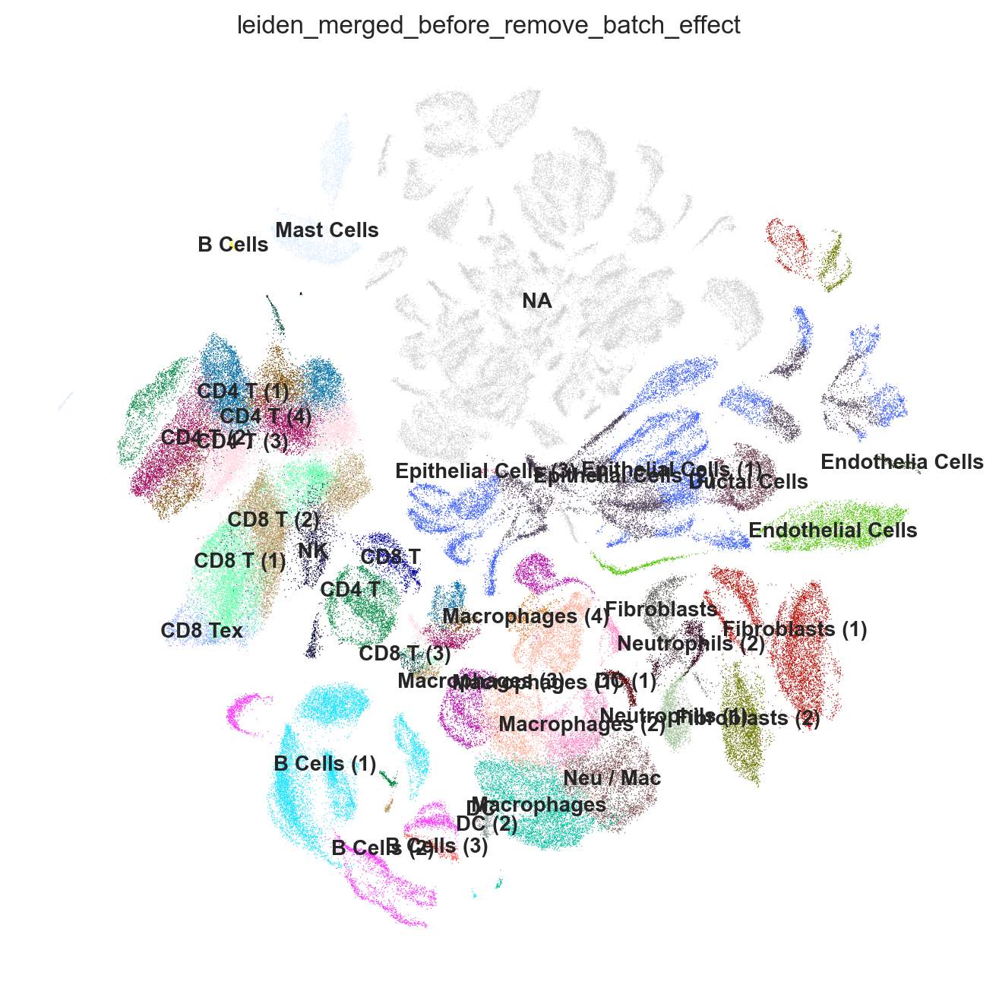

In [21]:
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(merged_dataset, color='leiden_1st', legend_loc='on data', legend_fontsize='small', 
           title='leiden_{}'.format('merged_before_remove_batch_effect'), frameon=False, 
           save='_merged_before_remove_batch_effect_leiden_1st_7ds.png')

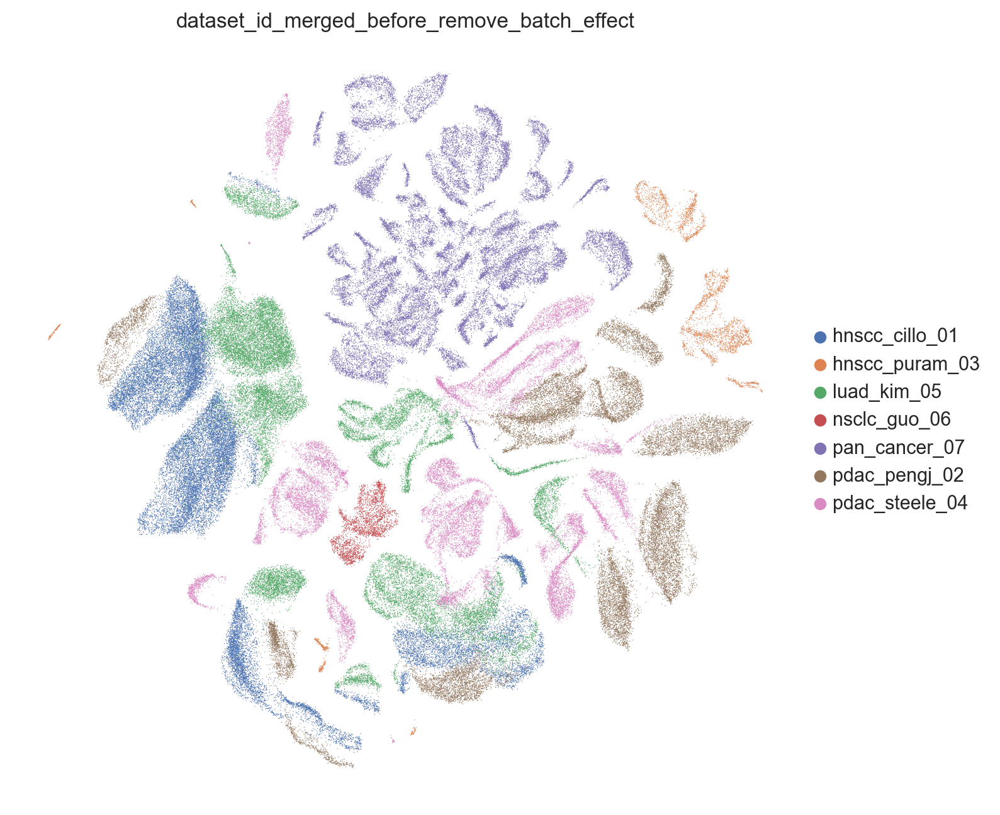

In [22]:
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(merged_dataset, color='dataset_id', 
           title='dataset_id_{}'.format('merged_before_remove_batch_effect'), frameon=False, 
           save='_merged_before_remove_batch_effect_dataset_id_7ds.png')

#### Batch effect correction by BBKNN
- https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html#BBKNN

In [23]:
%%time
sc.external.pp.bbknn(merged_dataset, batch_key='dataset_id')

CPU times: user 26.8 s, sys: 359 ms, total: 27.2 s
Wall time: 26.8 s


In [24]:
merged_dataset

AnnData object with n_obs × n_vars = 143660 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'cell_type', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group', 'leiden'
    var: 'gene_ids'
    uns: 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'leiden_1st_colors', 'dataset_id_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

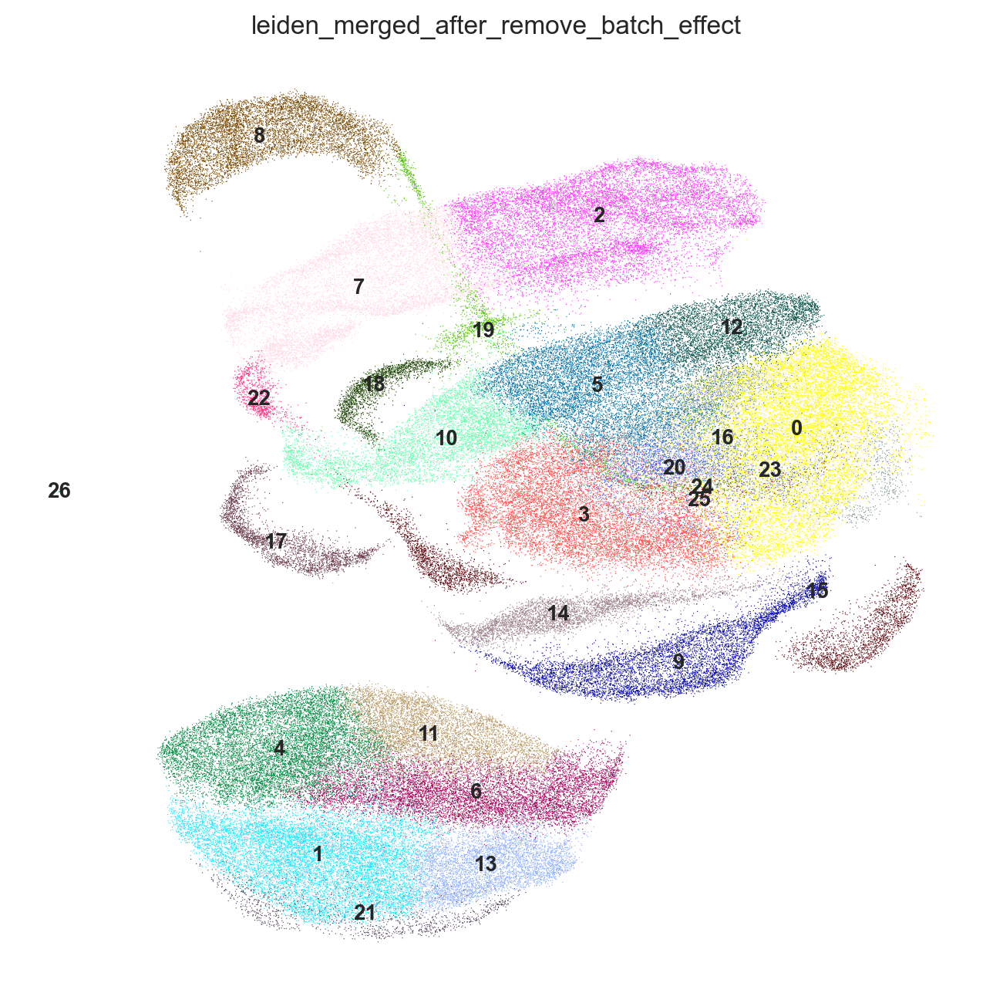

In [25]:
# sc.tl.pca(all_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=False)
# sc.pl.pca_variance_ratio(all_dataset, n_pcs=30)
# print(all_dataset.obsm['X_pca'].shape)
# sc.pp.neighbors(all_dataset, n_neighbors=10, n_pcs=40)
sc.tl.umap(merged_dataset)
sc.tl.leiden(merged_dataset)
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(merged_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', 
           title='leiden_{}'.format('merged_after_remove_batch_effect'), frameon=False, 
           save='_merged_after_remove_batch_effect_leiden_7ds.png')

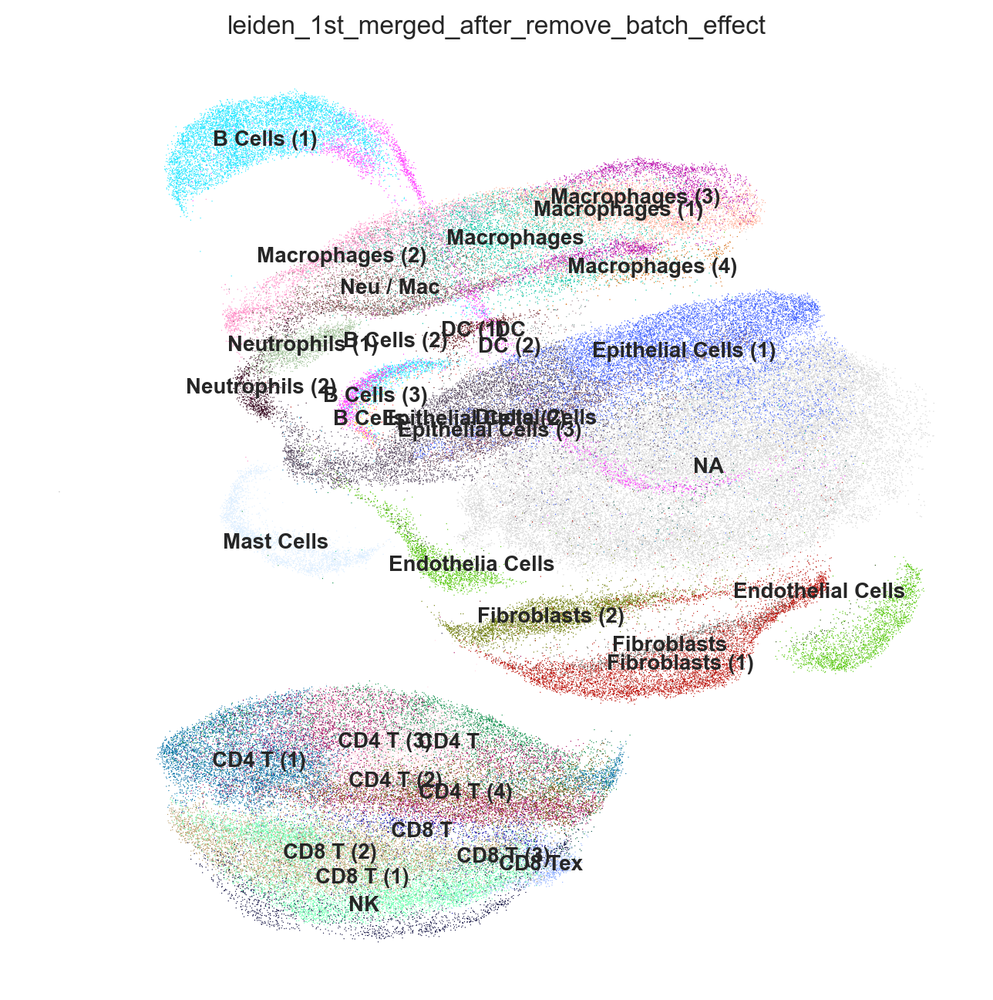

In [26]:
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(merged_dataset, color='leiden_1st', legend_loc='on data', legend_fontsize='small', 
           title='leiden_1st_{}'.format('merged_after_remove_batch_effect'), frameon=False, 
           save='_merged_after_remove_batch_effect_leiden_1st_7ds.png')

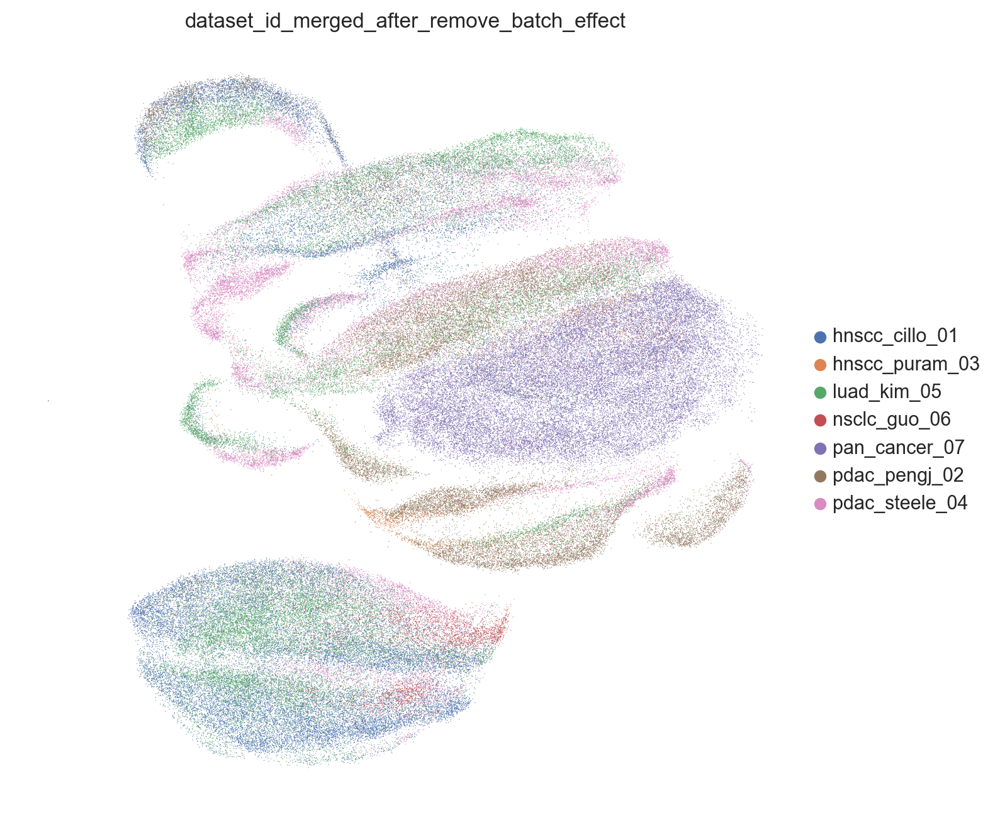

In [27]:
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(merged_dataset, color='dataset_id', 
           title='dataset_id_{}'.format('merged_after_remove_batch_effect'), frameon=False, 
           save='_merged_after_remove_batch_effect_dataset_id_7ds.png')

In [28]:
merged_dataset.write(os.path.join(root_dir, '7_dataset_merged_after_batch_correction.h5ad'))

In [29]:
merged_dataset = sc.read_h5ad(os.path.join(root_dir, '7_dataset_merged_after_batch_correction.h5ad'))
merged_dataset

AnnData object with n_obs × n_vars = 143660 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'cell_type', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group', 'leiden'
    var: 'gene_ids'
    uns: 'dataset_id_colors', 'leiden', 'leiden_1st_colors', 'leiden_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

#### Finding marker genes

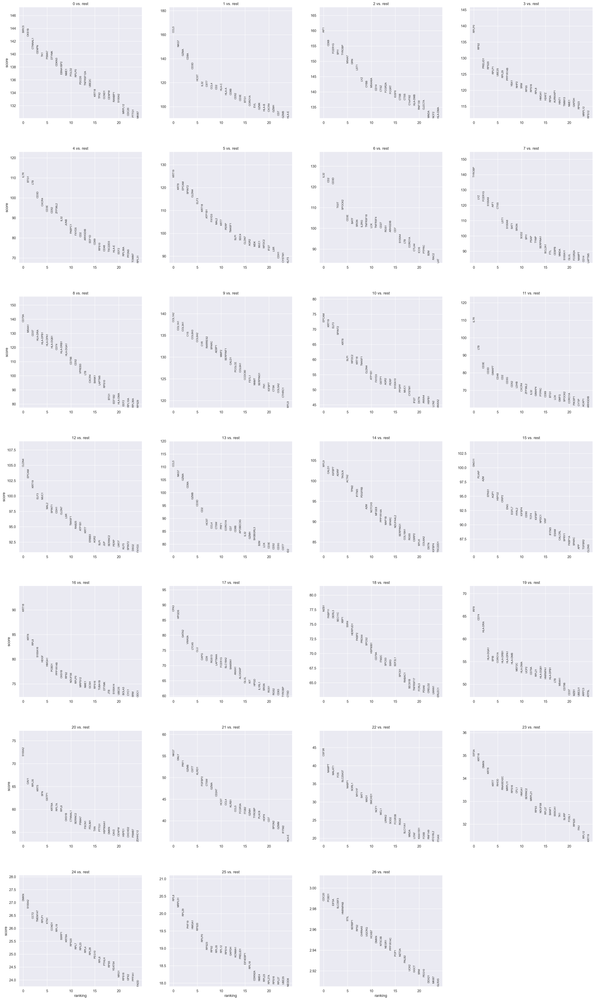

In [30]:
# rcParams['figure.figsize'] = 12, 12
sc.tl.rank_genes_groups(merged_dataset, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(merged_dataset, n_genes=25, sharey=False)

In [31]:
top30 = pd.DataFrame(merged_dataset.uns['rank_genes_groups']['names']).head(30)
top30

,0,1,2,3,4,5,6,7,8,9,...,17,18,19,20,21,22,23,24,25,26
0,BIRC5,CCL5,AIF1,RPLP0,IL7R,KRT19,IL32,TYROBP,CD79A,COL1A2,...,CPA3,MZB1,IRF8,S100A2,NKG7,CSF3R,EIF5A,DMKN,RPL8,CDC20
1,CKS1B,NKG7,CD68,RPS2,BTG1,KRT8,CD2,LYZ,MS4A1,COL1A1,...,HPGDS,FKBP11,CD74,CAV1,GNLY,NAMPT,KRT18,S100A2,MRPL51,PCBD1
2,CTNNAL1,GZMA,FCER1G,PRELID1,LTB,EPCAM,CD3D,FCER1G,CD37,COL3A1,...,GATA2,DERL3,HLA-DRA,RPL35,PRF1,MALAT1,DMKN,CCT2,RPL29,EIF5A
3,CENPN,CD8A,SPI1,RPS20,CD3D,SPINT2,TIGIT,S100A9,HLA-DRA,C1S,...,VWA5A,SEC11C,HLA-DQA1,KRT5,GZMB,FOS,KRT8,TMEM147,PHF19,SLC35F3
4,TK1,CD3D,TYROBP,RPLP1,CXCR4,CLDN4,SPOCK2,AIF1,HLA-DPB1,COL6A3,...,LTC4S,XBP1,SPIB,SFN,CST7,SLC25A37,KRT7,RPLP1,HMGA1,HNRNPAB
5,PSMA7,HCST,MS4A7,UBE2S,CD3E,ELF3,CD3E,CTSS,HLA-DPA1,COL6A2,...,CLU,SSR4,CORO1A,GSTP1,KLRD1,NABP1,RHOD,KTN1,RPS20,STIL
6,DTYMK,IL32,GRN,RPL29,CD52,KRT18,BATF,LST1,HLA-DQB1,C1R,...,CAPG,HERPUD1,HLA-DRB1,KRT6A,FGFBP2,SORL1,RNASEH2C,CCND1,RPLP0,SERBP1
7,CDKN3,CST7,LST1,PPP1R14B,ZFP36L2,ATP1B1,SRGN,S100A8,CD74,RARRES2,...,CD9,FKBP2,HLA-DPA1,RPL7A,CTSW,MYO1F,MRPL11,RPL19,RPS23,RPS2
8,EBNA1BP2,CCL4,LYZ,YBX1,IL32,FXYD3,IL2RG,SAT1,HLA-DRB1,SPARC,...,RGS13,PRDX4,HLA-DMB,RPL8,GZMA,SAT1,RPS16,SSRP1,RPS2,CHRNA5
9,NME1,CD2,CYBB,NHP2,JUNB,MAL2,TNFRSF18,SRGN,HLA-DQA1,AEBP1,...,LAPTM4A,SPCS2,MEF2C,CKS1B,CD247,MXD1,CFL1,KRT6A,RPL35,UQCRQ


In [32]:
common_marker_gene = pd.read_csv('selected_marker_genes.csv', index_col=0)
common_marker_gene.head(2)

,cell_type,subset,PMID,comment,core_marker
marker_gene,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN


In [33]:
for cluster_id in top30:
    print('Current cluster id: {}'.format(cluster_id))
    print(top30.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(2)])

Current cluster id: 0
        0         cell_type
15  KRT18  Epithelial Cells
15  KRT18  Epithelial Cells
Current cluster id: 1
       1 cell_type
0   CCL5     CD8 T
1   NKG7        NK
2   GZMA     CD8 T
3   CD8A     CD8 T
4   CD3D   T Cells
9    CD2   T Cells
12  CD8B     CD8 T
14  CD3E   T Cells
23  GZMB        DC
Current cluster id: 2
         2                cell_type
0     AIF1              Macrophages
1     CD68              Macrophages
5    MS4A7              Macrophages
8      LYZ              Macrophages
11    CD14              Macrophages
13  FCGR2A  Macrophages (discarded)
16    CTSB              Macrophages
Current cluster id: 3
          3 cell_type
7  PPP1R14B        DC
Current cluster id: 4
       4 cell_type
0   IL7R     CD4 T
3   CD3D   T Cells
5   CD3E   T Cells
12   CD2   T Cells
Current cluster id: 5
        5         cell_type
0   KRT19  Epithelial Cells
0   KRT19  Epithelial Cells
0   KRT19  Epithelial Cells
1    KRT8  Epithelial Cells
2   EPCAM  Epithelial Cells

In [34]:
marker_genes1 = ["PDCD1", "IFNG", "CD2", "CD3D", "CD3E", # T Cell
                 "BATF", "ICOS", "IL7R", "SELL", "TNFRSF4", "CXCL13", "CXCR5", "MAF", "IL12RB2", "STAT4", "CREM", "IRF4", "NR4A2", 
                 "GATA3", "STAT6", "TCF7", "IKZF2", "IL2RA", "TGFB1", "TGFB3", "TGFBR1", "CD28", "TNFRSF14", "TNFRSF9", 
                 "FOXP3", "CTLA4", "TIGIT", "CCR7", "CD4",  # CD4 T
                 "CX3CR1", "CCL5", "CD8A", "CD8B", "GZMA", "LAYN", "LAG3", "GZMB", "GNLY", "NKG7", "PRF1", # CD8 T
                 "NCAM1", "XCL1", "KLRD1", "SAMD3", "TBX21"]  # NK

In [35]:
marker_genes2 = ["BANK1", "CD19", "CD22", "CD79A", "FCRL5", "MS4A1", "SLAMF7", # B Cells
                 "CLEC10A", "LAMP3", "CD80", "CD83", "IRF8", "MZB1", "CD40", 'IRF7', 'FSCN1', # DC
                 "CLDN5", "ENG", "PLVAP", "VWF", # Endothelial Cells
                 "COL1A1", "COL1A2", "COL3A1", "MYL9",  # Fibroblasts
                 "AIF1", "CD14", "CD163", "CD68", "CTSB", "FCGR2A", "FCGR3B", "LYZ", "MS4A7", "FCGR3A", # Macrophages
                 # "CMA1", "MS4A2", # Mast Cells
                 'CPA3', 'HPGDS', 'GATA2',  # top 3 genes in cluster 12
                 "CFLAR", "CSF3R", "CXCR2", "FPR1", "S100A8", "S100A9", "SLC25A37", # Neutrophils
                 "CDH1", "EPCAM", "KRT18", "KRT19", 'KRT5', 'KRT8']  # Epithelial cells

In [36]:
sc.tl.dendrogram(adata=merged_dataset, groupby='leiden')

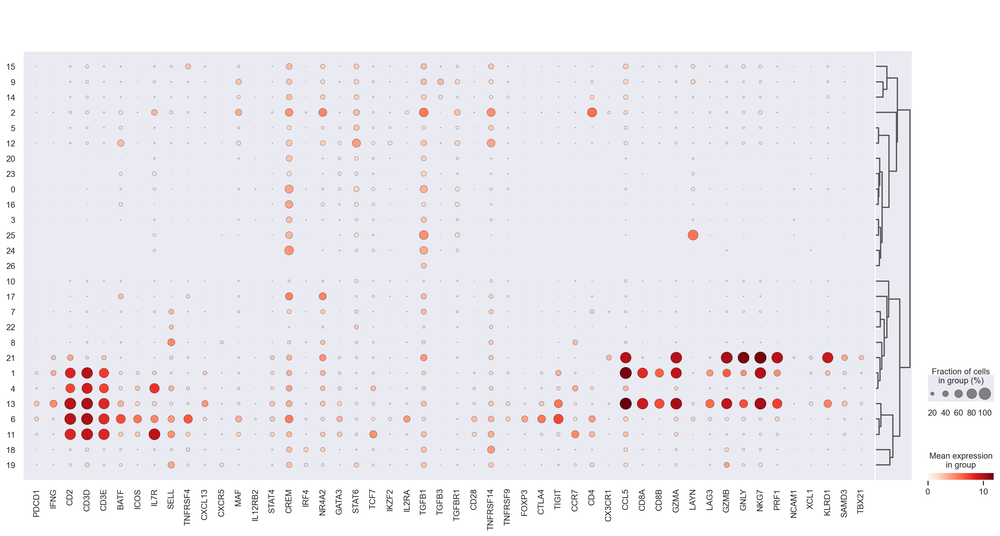

In [37]:
sc.pl.dotplot(merged_dataset, marker_genes1, groupby='leiden', save='marker_genes_dotplot1.png', dendrogram=True)

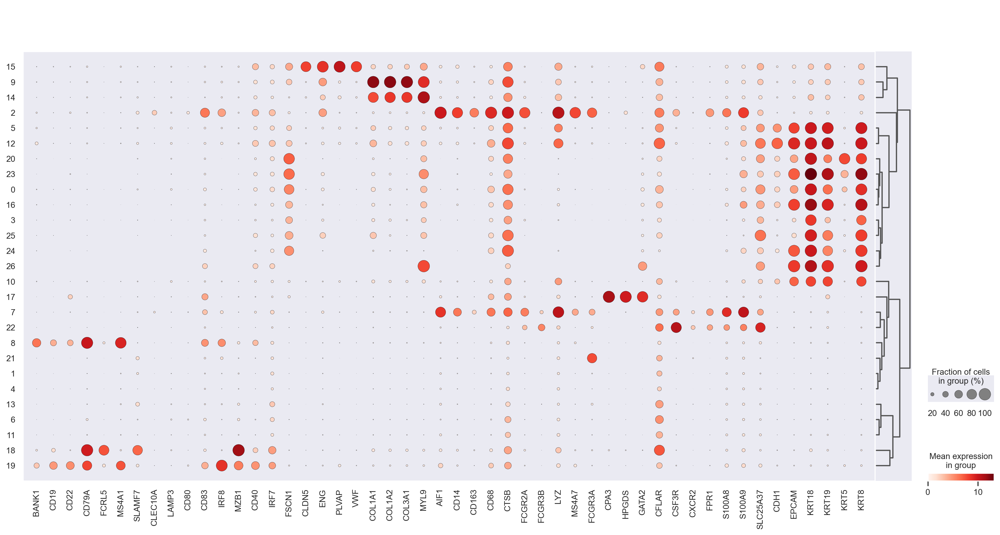

In [38]:
sc.pl.dotplot(merged_dataset, marker_genes2, groupby='leiden', save='marker_genes_dotplot2.png', dendrogram=True)

In [39]:
new_cluster_names = {
      0: 'Epithelial Cells (1)',
      1: 'CD8 T (1)',
      2: 'Macrophages (1)',
      3: 'Epithelial Cells (2)',
      4: 'CD4 T (1)',
      5: 'Epithelial Cells (3)',
      6: 'CD4 T (2)',
      7: 'Macrophages (2)',
      8: 'B Cells (1)',
      9: 'Fibroblasts (1)',
      10: 'Epithelial Cells (4)',
      11: 'CD4 T (3)',
      12: 'Epithelial Cells (5)',
      13: 'CD8 T (2)',
      14: 'Fibroblasts (2)',
      15: 'Endothelial Cells',
      16: 'Epithelial Cells (6)',
      17: 'Mast Cells',
      18: 'B Cells (2)',
      19: 'DC',
      20: 'Epithelial Cells (7)',
      21: 'NK',
      22: 'Neutrophils',
      23: 'Epithelial Cells (8)',
      24: 'Epithelial Cells (9)',
      25: 'Epithelial Cells (10)',
      26: '26',
    
}
new_cluster_names_val = list(new_cluster_names.values())
print(new_cluster_names_val)
merged_dataset.rename_categories('leiden', new_cluster_names_val)

['Epithelial Cells (1)', 'CD8 T (1)', 'Macrophages (1)', 'Epithelial Cells (2)', 'CD4 T (1)', 'Epithelial Cells (3)', 'CD4 T (2)', 'Macrophages (2)', 'B Cells (1)', 'Fibroblasts (1)', 'Epithelial Cells (4)', 'CD4 T (3)', 'Epithelial Cells (5)', 'CD8 T (2)', 'Fibroblasts (2)', 'Endothelial Cells', 'Epithelial Cells (6)', 'Mast Cells', 'B Cells (2)', 'DC', 'Epithelial Cells (7)', 'NK', 'Neutrophils', 'Epithelial Cells (8)', 'Epithelial Cells (9)', 'Epithelial Cells (10)', '26']


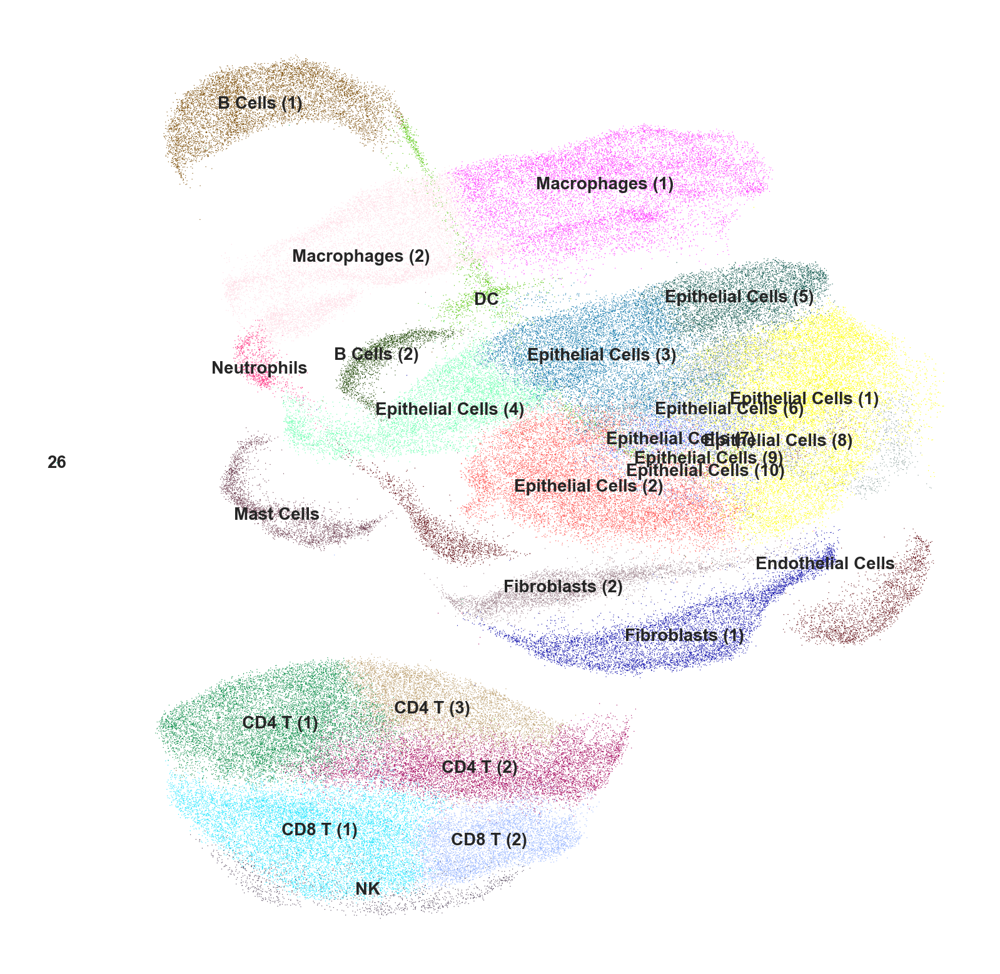

In [40]:
rcParams['figure.figsize'] = 10, 10
sc.pl.umap(merged_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='_merged.png')

In [41]:
merged_dataset

AnnData object with n_obs × n_vars = 143660 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'cell_type', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group', 'leiden'
    var: 'gene_ids'
    uns: 'dataset_id_colors', 'leiden', 'leiden_1st_colors', 'leiden_colors', 'neighbors', 'pca', 'umap', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [42]:
merged_dataset.write(os.path.join(root_dir, '7_dataset_merged_after_batch_correction.h5ad'))

In [43]:
merged_dataset = sc.read_h5ad(os.path.join(root_dir, '7_dataset_merged_after_batch_correction.h5ad'))
merged_dataset

AnnData object with n_obs × n_vars = 143660 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'cell_type', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group', 'leiden'
    var: 'gene_ids'
    uns: 'dataset_id_colors', 'dendrogram_leiden', 'leiden', 'leiden_1st_colors', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [44]:
merged_dataset.obs['leiden']

AAACCTGTCTTCGAGA-1_HNSCC_1_TIL-0-0-0-0-0-0         Macrophages (2)
AAAGATGAGCTAGTCT-1_HNSCC_1_TIL-0-0-0-0-0-0         Macrophages (1)
AAAGATGGTTATGTGC-1_HNSCC_1_TIL-0-0-0-0-0-0               CD4 T (1)
AAAGATGTCTATCGCC-1_HNSCC_1_TIL-0-0-0-0-0-0               CD4 T (1)
AAAGTAGAGAGACTTA-1_HNSCC_1_TIL-0-0-0-0-0-0               CD4 T (2)
                                                      ...         
c4708-1                                       Epithelial Cells (1)
c4714-1                                       Epithelial Cells (1)
c4722-1                                       Epithelial Cells (3)
c4735-1                                       Epithelial Cells (1)
c4741-1                                       Epithelial Cells (1)
Name: leiden, Length: 143660, dtype: category
Categories (27, object): ['Epithelial Cells (1)', 'CD8 T (1)', 'Macrophages (1)', 'Epithelial Cells (2)', ..., 'Epithelial Cells (8)', 'Epithelial Cells (9)', 'Epithelial Cells (10)', '26']

In [45]:
merged_dataset.obs.head(2)

,sample_id,leiden_1st,dataset_id,cell_type,hit_cell_type,m_max_cd4/mean_cd8,m_cd4/m_cd8 group,leiden
AAACCTGTCTTCGAGA-1_HNSCC_1_TIL-0-0-0-0-0-0,HNSCC_1_TIL,Neu / Mac,hnscc_cillo_01,Macrophages,Macrophages,2.0,high,Macrophages (2)
AAAGATGAGCTAGTCT-1_HNSCC_1_TIL-0-0-0-0-0-0,HNSCC_1_TIL,Macrophages,hnscc_cillo_01,Macrophages,Macrophages,2.0,high,Macrophages (1)


In [46]:
merged_dataset.obs['leiden_1st'].cat.add_categories('Epithelial Cells', inplace=True)
merged_dataset.obs.loc[merged_dataset.obs['leiden_1st'].isna(), 'leiden_1st'] = 'Epithelial Cells'

In [47]:
merged_dataset.obs.groupby('leiden').size()

leiden
Epithelial Cells (1)     13468
CD8 T (1)                11225
Macrophages (1)          11202
Epithelial Cells (2)     10570
CD4 T (1)                10188
Epithelial Cells (3)      9664
CD4 T (2)                 9001
Macrophages (2)           8851
B Cells (1)               7602
Fibroblasts (1)           6928
Epithelial Cells (4)      6045
CD4 T (3)                 5866
Epithelial Cells (5)      5184
CD8 T (2)                 5136
Fibroblasts (2)           3917
Endothelial Cells         3718
Epithelial Cells (6)      3511
Mast Cells                2730
B Cells (2)               2064
DC                        1953
Epithelial Cells (7)      1936
NK                        1185
Neutrophils                882
Epithelial Cells (8)       431
Epithelial Cells (9)       250
Epithelial Cells (10)      150
26                           3
dtype: int64

#### Filtering
- step1: The number of cells in clusters after grouping by `leiden_1st` and `dataset_id` >= 30;
- step2: The number of cells in clusters after grouping by `leiden`, `leiden_1st` and `dataset_id` >= 200, but keep the clusters which the number of cells <= 200 in step1;
- step3: Set `cell_type1` based on `leiden_1st` for the annotated cell type before merged, set `cell_type` based on `leiden` for the annotated cell type after merged, set `Stellate cells` in `pdac_pengj_02` as a subtype of `Fibroblasts` (Cancer associated fibroblasts), (Awaji M, Singh R K. Cancers, 2019, 11(3): 290.; Öhlund D. et al., J Exp Med, 2014, 211(8): 1503-1523.);
- step4: Only keep the cells which have same annotated cell type before and after merged.

In [48]:
count_by_leiden_1st = merged_dataset.obs.groupby(['leiden_1st', 'dataset_id']).size().reset_index(name='counts')
count_by_leiden_1st = count_by_leiden_1st.loc[count_by_leiden_1st['counts']>=30, :].copy()
count_by_leiden_1st['label_leiden_1st'] = ['-'.join(j.loc[['leiden_1st', 'dataset_id']].values) for i,j in count_by_leiden_1st.iterrows()]
count_by_leiden_1st.to_csv(os.path.join(root_dir, '7_dataset_merged_clustering_info_count_by_leiden_1st.csv'))
count_by_leiden_1st.head(2)

,leiden_1st,dataset_id,counts,label_leiden_1st
1,B Cells,hnscc_puram_03,67,B Cells-hnscc_puram_03
7,B Cells (1),hnscc_cillo_01,3208,B Cells (1)-hnscc_cillo_01


In [49]:
# Small clusters (number of cells <= 200) in leiden_1st
less200_leiden_1st = count_by_leiden_1st.loc[count_by_leiden_1st['counts'] <= 200, :].copy()
less200_leiden_1st

,leiden_1st,dataset_id,counts,label_leiden_1st
1,B Cells,hnscc_puram_03,67,B Cells-hnscc_puram_03
29,CD4 T,hnscc_puram_03,174,CD4 T-hnscc_puram_03
73,CD8 T (1),nsclc_guo_06,104,CD8 T (1)-nsclc_guo_06
78,CD8 T (2),hnscc_puram_03,102,CD8 T (2)-hnscc_puram_03
86,CD8 T (3),luad_kim_05,181,CD8 T (3)-luad_kim_05
100,DC,luad_kim_05,119,DC-luad_kim_05
127,Endothelia Cells,hnscc_puram_03,196,Endothelia Cells-hnscc_puram_03
139,Endothelial Cells,pdac_steele_04,138,Endothelial Cells-pdac_steele_04
156,Epithelial Cells (3),luad_kim_05,33,Epithelial Cells (3)-luad_kim_05
183,Macrophages,hnscc_puram_03,52,Macrophages-hnscc_puram_03


In [50]:
merged_clusters_info = merged_dataset.obs.groupby(['leiden', 'leiden_1st', 'dataset_id']).size().reset_index(name='counts')
merged_clusters_info['label_leiden_1st'] = ['-'.join(j.loc[['leiden_1st', 'dataset_id']].values) for i,j in merged_clusters_info.iterrows()]
merged_clusters_info['label'] = ['-'.join(j.loc[['leiden', 'leiden_1st', 'dataset_id']].values) for i,j in merged_clusters_info.iterrows()]
merged_clusters_info.to_csv(os.path.join(root_dir, '7_dataset_merged_clustering_info_before_removing_inconsistency.csv'))
merged_clusters_info.head(2)

,leiden,leiden_1st,dataset_id,counts,label_leiden_1st,label
0,Epithelial Cells (1),B Cells,hnscc_cillo_01,0,B Cells-hnscc_cillo_01,Epithelial Cells (1)-B Cells-hnscc_cillo_01
1,Epithelial Cells (1),B Cells,hnscc_puram_03,0,B Cells-hnscc_puram_03,Epithelial Cells (1)-B Cells-hnscc_puram_03


In [51]:
part1 = merged_clusters_info.loc[merged_clusters_info['counts'] >= 200, :].copy()
print(part1.shape)
part2 = merged_clusters_info.loc[(merged_clusters_info['label_leiden_1st'].isin(less200_leiden_1st['label_leiden_1st'].to_list())) &
                                 (merged_clusters_info['counts'] >= 1)].copy()
print(part2.shape)

(98, 6)
(30, 6)


In [52]:
filtered_clusters_info = pd.concat([part1, part2])
filtered_clusters_info.shape

(128, 6)

In [53]:
sorted(list(filtered_clusters_info.leiden.unique()))

['B Cells (1)',
 'B Cells (2)',
 'CD4 T (1)',
 'CD4 T (2)',
 'CD4 T (3)',
 'CD8 T (1)',
 'CD8 T (2)',
 'DC',
 'Endothelial Cells',
 'Epithelial Cells (1)',
 'Epithelial Cells (2)',
 'Epithelial Cells (3)',
 'Epithelial Cells (4)',
 'Epithelial Cells (5)',
 'Epithelial Cells (6)',
 'Epithelial Cells (7)',
 'Epithelial Cells (8)',
 'Epithelial Cells (9)',
 'Fibroblasts (1)',
 'Fibroblasts (2)',
 'Macrophages (1)',
 'Macrophages (2)',
 'Mast Cells',
 'NK',
 'Neutrophils']

In [54]:
cell_type_mapping_leiden = {
 'B Cells (1)': 'B Cells',
 'B Cells (2)': 'B Cells',
 'CD4 T (1)': 'CD4 T',
 'CD4 T (2)': 'CD4 T',
 'CD4 T (3)': 'CD4 T',
 'CD8 T (1)': 'CD8 T',
 'CD8 T (2)': 'CD8 T',
 'DC': 'DC',
 'Endothelial Cells': 'Endothelial Cells',
 'Epithelial Cells (1)': 'Cancer Cells',
 'Epithelial Cells (2)': 'Cancer Cells',
 'Epithelial Cells (3)': 'Cancer Cells',
 'Epithelial Cells (4)': 'Cancer Cells',
 'Epithelial Cells (5)': 'Cancer Cells',
 'Epithelial Cells (6)': 'Cancer Cells',
 'Epithelial Cells (7)': 'Cancer Cells',
 'Epithelial Cells (8)': 'Cancer Cells',
 'Epithelial Cells (9)': 'Cancer Cells',
 'Fibroblasts (1)': 'Fibroblasts',
 'Fibroblasts (2)': 'Fibroblasts',
 'Macrophages (1)': 'Macrophages',
 'Macrophages (2)': 'Macrophages',
 'Mast Cells': 'Mast Cells',
 'NK': 'NK',
 'Neutrophils': 'Neutrophils'
}

In [55]:
sorted(list(filtered_clusters_info.leiden_1st.unique()))

['B Cells',
 'B Cells (1)',
 'B Cells (2)',
 'B Cells (3)',
 'CD4 T',
 'CD4 T (1)',
 'CD4 T (2)',
 'CD4 T (3)',
 'CD4 T (4)',
 'CD8 T',
 'CD8 T (1)',
 'CD8 T (2)',
 'CD8 T (3)',
 'CD8 Tex',
 'DC',
 'DC (1)',
 'Ductal Cells',
 'Endothelia Cells',
 'Endothelial Cells',
 'Epithelial Cells',
 'Epithelial Cells (1)',
 'Epithelial Cells (2)',
 'Epithelial Cells (3)',
 'Fibroblasts',
 'Fibroblasts (1)',
 'Fibroblasts (2)',
 'Macrophages',
 'Macrophages (1)',
 'Macrophages (2)',
 'Macrophages (3)',
 'Macrophages (4)',
 'Mast Cells',
 'NK',
 'Neu / Mac',
 'Neutrophils (1)',
 'Neutrophils (2)']

In [56]:
cell_type_mapping_leiden_1st = {
 'B Cells': 'B Cells',
 'B Cells (1)': 'B Cells',
 'B Cells (2)': 'B Cells',
 'B Cells (3)': 'B Cells',
 'CD4 T': 'CD4 T',
 'CD4 T (1)': 'CD4 T',
 'CD4 T (2)': 'CD4 T',
 'CD4 T (3)': 'CD4 T',
 'CD4 T (4)': 'CD4 T',
 'CD8 T (1)': 'CD8 T',
 'CD8 T (2)': 'CD8 T',
 'CD8 T (3)': 'CD8 T',
 'CD8 T': 'CD8 T',
 'CD8 Tex': 'CD8 T',
 'DC': 'DC',
 'DC (1)': 'DC',
 'Ductal Cells': 'Cancer Cells',  # set Ductual Cells as Cancer Cells
 'Endothelia Cells': 'Endothelial Cells',
 'Endothelial Cells': 'Endothelial Cells',
 'Epithelial Cells': 'Cancer Cells',
 'Epithelial Cells (1)': 'Cancer Cells',  # set Epithelial Cells as Cancer Cells
 'Epithelial Cells (2)': 'Cancer Cells',
 'Epithelial Cells (3)': 'Cancer Cells',
 'Fibroblasts': 'Fibroblasts',
 'Fibroblasts (1)': 'Fibroblasts',
 'Fibroblasts (2)': 'Fibroblasts',
 'Macrophages': 'Macrophages',
 'Macrophages (1)': 'Macrophages',
 'Macrophages (2)': 'Macrophages',
 'Macrophages (3)': 'Macrophages',
 'Macrophages (4)': 'Macrophages',
 'Mast Cells': 'Mast Cells',
 'Neu / Mac': 'Macrophages',  # set this cluster as Macrophages
 'NK': 'NK',
 'Neutrophils (1)': 'Neutrophils',
 'Neutrophils (2)': 'Neutrophils'
}

In [57]:
filtered_clusters_info['cell_type'] = filtered_clusters_info.leiden.map(cell_type_mapping_leiden)
filtered_clusters_info['cell_type1'] = filtered_clusters_info.leiden_1st.map(cell_type_mapping_leiden_1st)
filtered_clusters_info.head(2)

,leiden,leiden_1st,dataset_id,counts,label_leiden_1st,label,cell_type,cell_type1
141,Epithelial Cells (1),Epithelial Cells (1),hnscc_puram_03,952,Epithelial Cells (1)-hnscc_puram_03,Epithelial Cells (1)-Epithelial Cells (1)-hnsc...,Cancer Cells,Cancer Cells
256,Epithelial Cells (1),Epithelial Cells,pan_cancer_07,11890,Epithelial Cells-pan_cancer_07,Epithelial Cells (1)-Epithelial Cells-pan_canc...,Cancer Cells,Cancer Cells


Remove the clusters which have different cell type before and after merged

In [58]:
filtered_clusters_info = filtered_clusters_info.loc[filtered_clusters_info.cell_type == filtered_clusters_info.cell_type1, :].copy()
filtered_clusters_info.shape

(109, 8)

In [59]:
merged_dataset.obs['label'] = ['-'.join(j.loc[['leiden', 'leiden_1st', 'dataset_id']].values) for i,j in merged_dataset.obs.iterrows()]
merged_dataset = merged_dataset[merged_dataset.obs['label'].isin(filtered_clusters_info.label), :].copy()
merged_dataset

AnnData object with n_obs × n_vars = 135049 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'cell_type', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group', 'leiden', 'label'
    var: 'gene_ids'
    uns: 'dataset_id_colors', 'dendrogram_leiden', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [60]:
merged_dataset.obs['cell_type'] = merged_dataset.obs['leiden'].map(cell_type_mapping_leiden)

In [61]:
merged_dataset.obs['leiden'].value_counts()

Epithelial Cells (1)    12842
Macrophages (1)         11124
CD8 T (1)               10619
Epithelial Cells (2)    10138
CD4 T (1)                9701
Epithelial Cells (3)     9330
CD4 T (2)                8626
B Cells (1)              7365
Fibroblasts (1)          6870
Macrophages (2)          6738
Epithelial Cells (4)     5761
CD4 T (3)                5578
Epithelial Cells (5)     5147
CD8 T (2)                4662
Fibroblasts (2)          3796
Endothelial Cells        3717
Epithelial Cells (6)     3441
Mast Cells               2713
B Cells (2)              2046
Epithelial Cells (7)     1861
NK                       1016
Neutrophils               734
DC                        543
Epithelial Cells (8)      431
Epithelial Cells (9)      250
Name: leiden, dtype: int64

In [62]:
merged_dataset.obs.to_csv(os.path.join(root_dir, 'merged_7_sc_datasets_info.csv'))

In [63]:
merged_dataset.obs['cell_type'].value_counts()

Cancer Cells         49201
CD4 T                23905
Macrophages          17862
CD8 T                15281
Fibroblasts          10666
B Cells               9411
Endothelial Cells     3717
Mast Cells            2713
NK                    1016
Neutrophils            734
DC                     543
Name: cell_type, dtype: int64

In [64]:
merged_dataset.write(os.path.join(root_dir, 'merged_7_sc_datasets.h5ad'))

... storing 'cell_type' as categorical
... storing 'label' as categorical


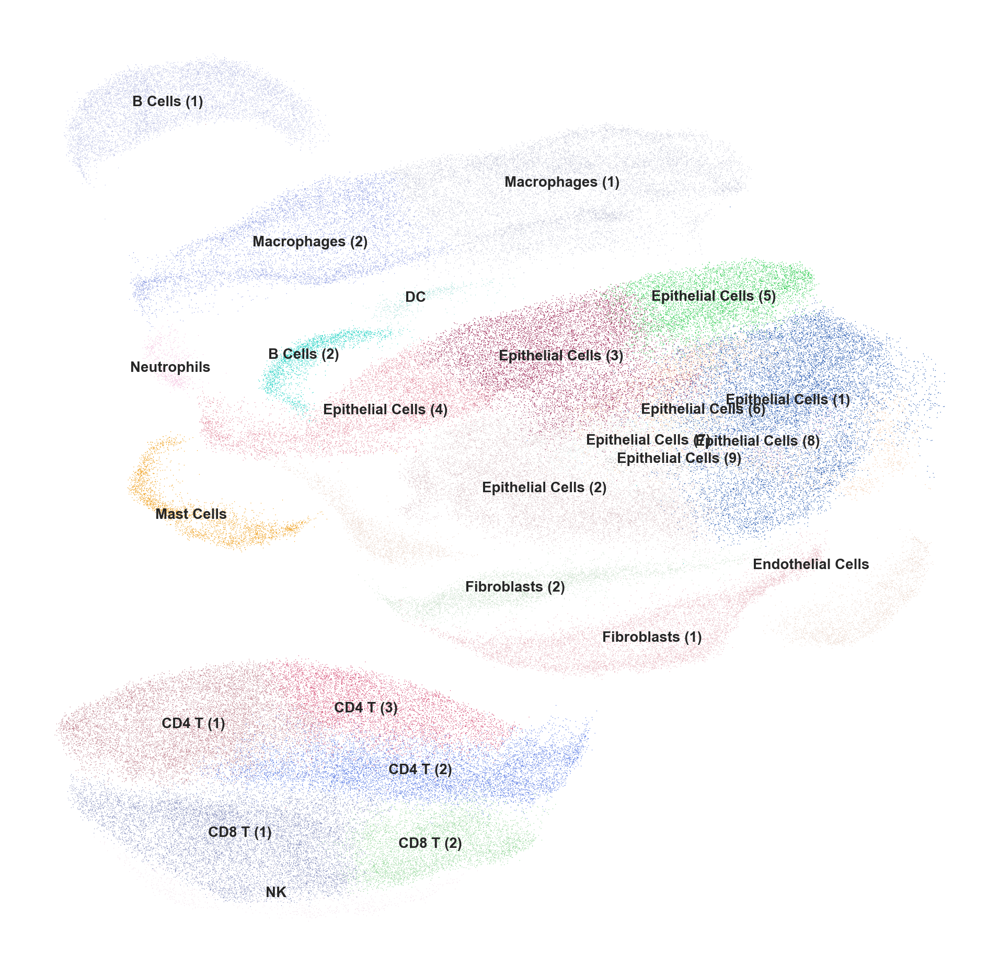

In [65]:
rcParams['figure.figsize'] = 12, 12
sc.pl.umap(merged_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, 
           save='_merged_filtered_leiden_7ds.png')

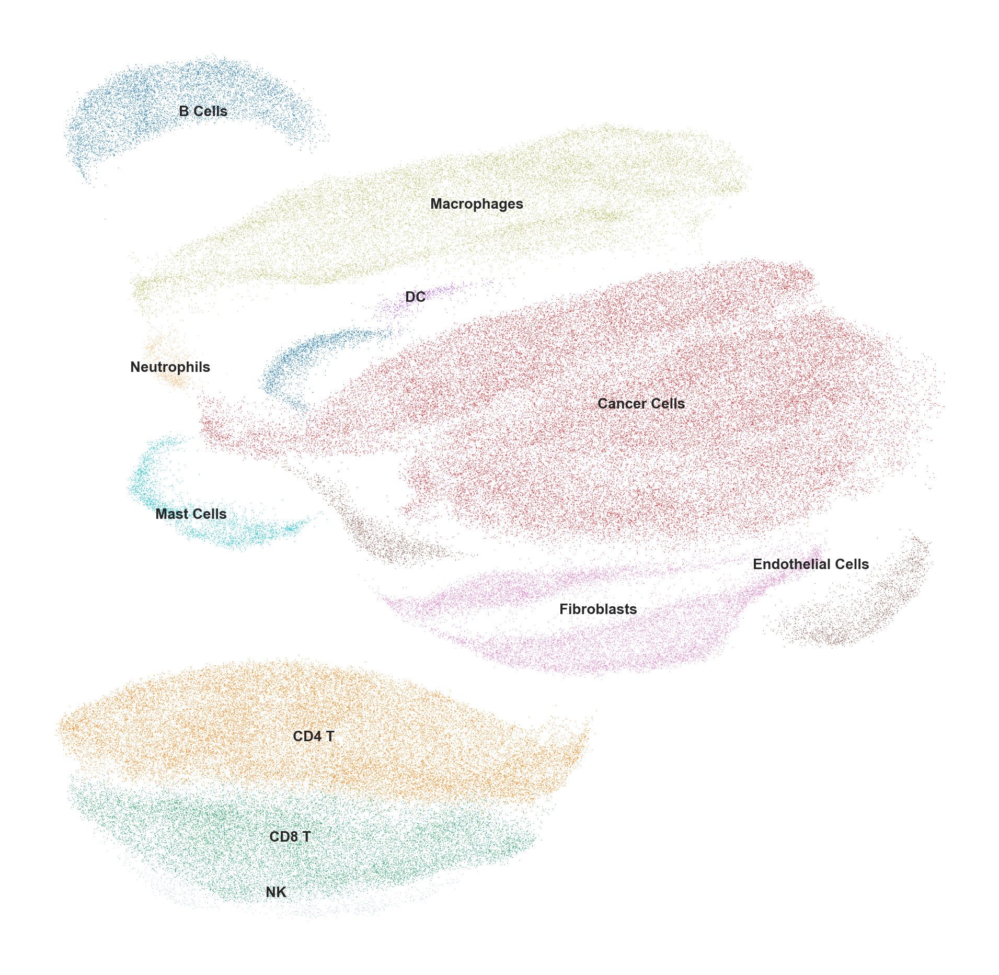

In [66]:
rcParams['figure.figsize'] = 12, 12
sc.pl.umap(merged_dataset, color='cell_type', legend_loc='on data', legend_fontsize='small', title='', frameon=False, 
           save='_merged_filtered_cell_type_7ds.png')

In [67]:
merged_dataset

AnnData object with n_obs × n_vars = 135049 × 12114
    obs: 'sample_id', 'leiden_1st', 'dataset_id', 'cell_type', 'hit_cell_type', 'm_max_cd4/mean_cd8', 'm_cd4/m_cd8 group', 'leiden', 'label'
    var: 'gene_ids'
    uns: 'dataset_id_colors', 'dendrogram_leiden', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_colors', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [68]:
common_gene = merged_dataset.var.copy()
common_gene = common_gene.reset_index()
common_gene.rename(columns={'index': 'gene_name'}, inplace=True)
common_gene.head()

,gene_name,gene_ids
0,A1BG,ENSG00000121410
1,A2M,ENSG00000175899
2,A4GALT,NaN
3,AAAS,ENSG00000094914
4,AACS,ENSG00000081760


In [69]:
common_gene.to_csv(os.path.join(root_dir, 'common_genes_in_single_cell_dataset.csv'))

In [70]:
merged_dataset.obs.groupby(['dataset_id']).count()

,sample_id,leiden_1st,cell_type,hit_cell_type,m_max_cd4/mean_cd8,m_cd4/m_cd8 group,leiden,label
dataset_id,,,,,,,,
hnscc_cillo_01,29706,29706,29706,29706,29706,29706,29706,29706
hnscc_puram_03,3371,3371,3371,3371,3371,3371,3371,3371
luad_kim_05,27749,27749,27749,27749,27749,27749,27749,27749
nsclc_guo_06,2095,2095,2095,2095,2095,2095,2095,2095
pan_cancer_07,0,30556,30556,0,0,0,30556,30556
pdac_pengj_02,23287,23287,23287,23287,23287,23287,23287,23287
pdac_steele_04,18285,18285,18285,18285,18285,18285,18285,18285
